#### Problem Statement

- The data given below contains information about past loan applicants and whether they ‘defaulted’. The aim is to identify patterns indicating that a person is likely to default, which may be used to deny the loan, reduce the loan amount, lend (to risky applicants) at a higher interest rate, etc.

 

- In this case study, we will use EDA to understand how consumer attributes and loan attributes influence the tendency of defaulting.

In [311]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

In [312]:
data = pd.read_csv('C:/Users/DELL/Desktop/loan.csv')

In [313]:
pd.set_option('display.max_columns',None)

In [314]:
data

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0,Jan-85,1,NaN,NaN,3,0,13648,83.70%,9,f,0.00,0.00,5863.155187,5833.84,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,NaN,May-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,Ryder,< 1 year,RENT,30000.0,Source Verified,Dec-11,Charged Off,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0,Apr-99,5,NaN,NaN,3,0,1687,9.40%,4,f,0.00,0.00,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,NaN,Sep-13,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,NaN,10+ years,RENT,12252.0,Not Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,small_business,real estate business,606xx,IL,8.72,0,Nov-01,2,NaN,NaN,2,0,2956,98.50%,10,f,0.00,0.00,3005.666844,3005.67,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,NaN,May-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.0,Source Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.00,0,Feb-96,1,35.0,NaN,10,0,5598,21%,37,f,0.00,0.00,12231.890000,12231.89,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,NaN,Apr-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

#### Domain Analysis

1. The dataset contains complete loan data for all loans issued through the 2007-2011, including the current loan status (Current, Charged-off, Fully Paid) and latest payment information.
2. The file has 39 thousand observations and 111 variables.
3. Loan_status being the target column has following description

                   a. Fully paid: The applicant has fully paid the loan (the principal and the interest amount).
   
                   b. Current: The applicant is in the process of paying the instalments, i.e.,
                        the tenure of the loan is not yet completed. These candidates are not labelled as ‘defaulted’.
   
                   c. Charged-off: The applicant has not paid the instalments in due time for a long period,
                        i.e., they have defaulted on the loan.


4. Idea here is to group by Fully paid and Current as NON-Defaulters and Charged-off as Defaulters 


#### Basic checks on the data

In [315]:
data.shape

(39717, 111)

- The data has 39717 rows and 111 columns

##### Checking for null values

In [316]:
null = data.isnull().mean() * 100

In [317]:
for column, percentage in null.items():
    print(column, percentage)

id 0.0
member_id 0.0
loan_amnt 0.0
funded_amnt 0.0
funded_amnt_inv 0.0
term 0.0
int_rate 0.0
installment 0.0
grade 0.0
sub_grade 0.0
emp_title 6.191303472064859
emp_length 2.7066495455346575
home_ownership 0.0
annual_inc 0.0
verification_status 0.0
issue_d 0.0
loan_status 0.0
pymnt_plan 0.0
url 0.0
desc 32.58554271470655
purpose 0.0
title 0.027695948838029054
zip_code 0.0
addr_state 0.0
dti 0.0
delinq_2yrs 0.0
earliest_cr_line 0.0
inq_last_6mths 0.0
mths_since_last_delinq 64.66248709620565
mths_since_last_record 92.98537150338646
open_acc 0.0
pub_rec 0.0
revol_bal 0.0
revol_util 0.12589067653649572
total_acc 0.0
initial_list_status 0.0
out_prncp 0.0
out_prncp_inv 0.0
total_pymnt 0.0
total_pymnt_inv 0.0
total_rec_prncp 0.0
total_rec_int 0.0
total_rec_late_fee 0.0
recoveries 0.0
collection_recovery_fee 0.0
last_pymnt_d 0.1787647606818239
last_pymnt_amnt 0.0
next_pymnt_d 97.12969257496789
last_credit_pull_d 0.0050356270614598285
collections_12_mths_ex_med 0.1409975577208752
mths_since_las

In [318]:
null[null>90]

mths_since_last_record             92.985372
next_pymnt_d                       97.129693
mths_since_last_major_derog       100.000000
annual_inc_joint                  100.000000
dti_joint                         100.000000
verification_status_joint         100.000000
tot_coll_amt                      100.000000
tot_cur_bal                       100.000000
open_acc_6m                       100.000000
open_il_6m                        100.000000
open_il_12m                       100.000000
open_il_24m                       100.000000
mths_since_rcnt_il                100.000000
total_bal_il                      100.000000
il_util                           100.000000
open_rv_12m                       100.000000
open_rv_24m                       100.000000
max_bal_bc                        100.000000
all_util                          100.000000
total_rev_hi_lim                  100.000000
inq_fi                            100.000000
total_cu_tl                       100.000000
inq_last_1

In [319]:
len(null[null>90])

56

In [301]:
pip install missingno


  Obtaining dependency information for missingno from https://files.pythonhosted.org/packages/87/22/cd5cf999af21c2f97486622c551ac3d07361ced8125121e907f588ff5f24/missingno-0.5.2-py3-none-any.whl.metadata


In [302]:
import missingno as msno

<Axes: >

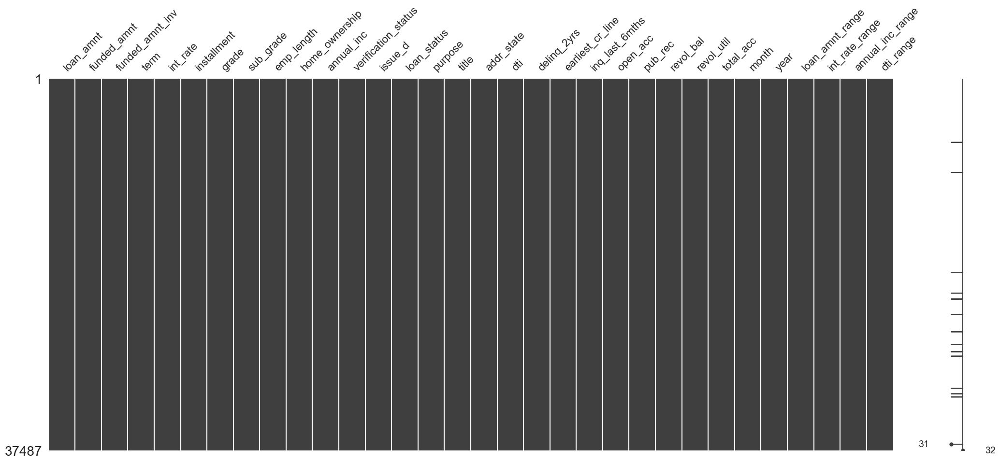

In [303]:
msno.matrix(data)

<Axes: >

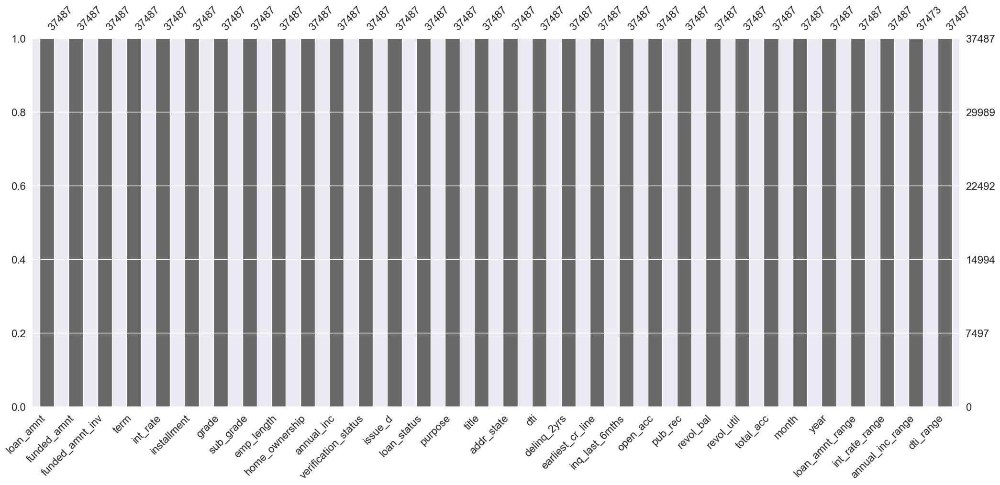

In [305]:
msno.bar(data)

##### Here 56 columns has null values >90

- Taking this into consideration , we can drop all these 56 columns with no information as it has no impact on the analysis

In [320]:
missing_columns = data.columns[100*(data.isnull().sum()/len(data.index)) > 90]

In [321]:
missing_columns

Index(['mths_since_last_record', 'next_pymnt_d', 'mths_since_last_major_derog',
       'annual_inc_joint', 'dti_joint', 'verification_status_joint',
       'tot_coll_amt', 'tot_cur_bal', 'open_acc_6m', 'open_il_6m',
       'open_il_12m', 'open_il_24m', 'mths_since_rcnt_il', 'total_bal_il',
       'il_util', 'open_rv_12m', 'open_rv_24m', 'max_bal_bc', 'all_util',
       'total_rev_hi_lim', 'inq_fi', 'total_cu_tl', 'inq_last_12m',
       'acc_open_past_24mths', 'avg_cur_bal', 'bc_open_to_buy', 'bc_util',
       'mo_sin_old_il_acct', 'mo_sin_old_rev_tl_op', 'mo_sin_rcnt_rev_tl_op',
       'mo_sin_rcnt_tl', 'mort_acc', 'mths_since_recent_bc',
       'mths_since_recent_bc_dlq', 'mths_since_recent_inq',
       'mths_since_recent_revol_delinq', 'num_accts_ever_120_pd',
       'num_actv_bc_tl', 'num_actv_rev_tl', 'num_bc_sats', 'num_bc_tl',
       'num_il_tl', 'num_op_rev_tl', 'num_rev_accts', 'num_rev_tl_bal_gt_0',
       'num_sats', 'num_tl_120dpd_2m', 'num_tl_30dpd', 'num_tl_90g_dpd_24m',
 

In [322]:
data = data.drop(missing_columns, axis=1)


Now we have 55 columns left out 111

In [323]:
data.isnull().mean() * 100

id                             0.000000
member_id                      0.000000
loan_amnt                      0.000000
funded_amnt                    0.000000
funded_amnt_inv                0.000000
term                           0.000000
int_rate                       0.000000
installment                    0.000000
grade                          0.000000
sub_grade                      0.000000
emp_title                      6.191303
emp_length                     2.706650
home_ownership                 0.000000
annual_inc                     0.000000
verification_status            0.000000
issue_d                        0.000000
loan_status                    0.000000
pymnt_plan                     0.000000
url                            0.000000
desc                          32.585543
purpose                        0.000000
title                          0.027696
zip_code                       0.000000
addr_state                     0.000000
dti                            0.000000


- Few more columns can be deleted based on % of null values

In [324]:
data.drop(columns=['emp_title','desc','pub_rec_bankruptcies','mths_since_last_delinq'],axis=1,inplace=True)

In [325]:
data.shape

(39717, 51)

In [87]:
data.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,collections_12_mths_ex_med,policy_code,application_type,acc_now_delinq,chargeoff_within_12_mths,delinq_amnt,tax_liens
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,credit_card,Computer,860xx,AZ,27.65,0,Jan-85,1,3,0,13648,83.70%,9,f,0.00,0.00,5863.155187,5833.84,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,May-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,< 1 year,RENT,30000.0,Source Verified,Dec-11,Charged Off,n,https://lendingclub.com/browse/loanDetail.acti...,car,bike,309xx,GA,1.00,0,Apr-99,5,3,0,1687,9.40%,4,f,0.00,0.00,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,Sep-13,0.0,1,INDIVIDUAL,0,0.0,0,0.0
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,10+ years,RENT,12252.0,Not Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,small_business,real estate business,606xx,IL,8.72,0,Nov-01,2,2,0,2956,98.50%,10,f,0.00,0.00,3005.666844,3005.67,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,May-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,10+ years,RENT,49200.0,Source Verified,Dec-11,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,other,personel,917xx,CA,20.00,0,Feb-96,1,10,0,5598,21%,37,f,0.00,0.00,12231.890000,12231.89,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,Apr-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,1 year,RENT,80000.0,Source Verified,Dec-11,Current,n,https://lendingclub.com/browse/loanDetail.acti...,other,Personal,972xx,OR,17.94,0,Jan-96,0,15,0,27783,53.90%,38,f,524.06,524.06,3513.330000,3513.33,2475.94,1037.39,0.00,0.00,0.00,May-16,67.79,May-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0


##### Checking for duplicates in the data

In [88]:
data.duplicated().sum()

0

- The data has no duplicate records,39717rows of information is a unique record

##### Checking for unique values in each column 

1. Helps in dropping those columns which as unique values throughout
2. Helps in checking the unique values alignment of all columns 


In [89]:
data.nunique()

id                            39717
member_id                     39717
loan_amnt                       885
funded_amnt                    1041
funded_amnt_inv                8205
term                              2
int_rate                        371
installment                   15383
grade                             7
sub_grade                        35
emp_length                       11
home_ownership                    5
annual_inc                     5318
verification_status               3
issue_d                          55
loan_status                       3
pymnt_plan                        1
url                           39717
purpose                          14
title                         19615
zip_code                        823
addr_state                       50
dti                            2868
delinq_2yrs                      11
earliest_cr_line                526
inq_last_6mths                    9
open_acc                         40
pub_rec                     

In [90]:
uni = data.nunique()
uni[uni==39717]

id           39717
member_id    39717
url          39717
dtype: int64

Since the above 3 columns has entire unique values, the columns should be dropped from the data

In [326]:
data.drop(columns=['id','member_id','url'],axis=1,inplace=True)

In [327]:
data.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,collections_12_mths_ex_med,policy_code,application_type,acc_now_delinq,chargeoff_within_12_mths,delinq_amnt,tax_liens
0,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,credit_card,Computer,860xx,AZ,27.65,0,Jan-85,1,3,0,13648,83.70%,9,f,0.00,0.00,5863.155187,5833.84,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,May-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0
1,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,< 1 year,RENT,30000.0,Source Verified,Dec-11,Charged Off,n,car,bike,309xx,GA,1.00,0,Apr-99,5,3,0,1687,9.40%,4,f,0.00,0.00,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,Sep-13,0.0,1,INDIVIDUAL,0,0.0,0,0.0
2,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,10+ years,RENT,12252.0,Not Verified,Dec-11,Fully Paid,n,small_business,real estate business,606xx,IL,8.72,0,Nov-01,2,2,0,2956,98.50%,10,f,0.00,0.00,3005.666844,3005.67,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,May-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0
3,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,10+ years,RENT,49200.0,Source Verified,Dec-11,Fully Paid,n,other,personel,917xx,CA,20.00,0,Feb-96,1,10,0,5598,21%,37,f,0.00,0.00,12231.890000,12231.89,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,Apr-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0
4,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,1 year,RENT,80000.0,Source Verified,Dec-11,Current,n,other,Personal,972xx,OR,17.94,0,Jan-96,0,15,0,27783,53.90%,38,f,524.06,524.06,3513.330000,3513.33,2475.94,1037.39,0.00,0.00,0.00,May-16,67.79,May-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0


In [328]:
data.describe()

,loan_amnt,funded_amnt,funded_amnt_inv,installment,annual_inc,dti,delinq_2yrs,inq_last_6mths,open_acc,pub_rec,revol_bal,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,collections_12_mths_ex_med,policy_code,acc_now_delinq,chargeoff_within_12_mths,delinq_amnt,tax_liens
count,39717.000000,39717.000000,39717.000000,39717.000000,3.971700e+04,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39717.000000,39661.0,39717.0,39717.0,39661.0,39717.0,39678.0
mean,11219.443815,10947.713196,10397.448868,324.561922,6.896893e+04,13.315130,0.146512,0.869200,9.294408,0.055065,13382.528086,22.088828,51.227887,50.989768,12153.596544,11567.149118,9793.348813,2263.663172,1.363015,95.221624,12.406112,2678.826162,0.0,1.0,0.0,0.0,0.0,0.0
std,7456.670694,7187.238670,7128.450439,208.874874,6.379377e+04,6.678594,0.491812,1.070219,4.400282,0.237200,15885.016641,11.401709,375.172839,373.824457,9042.040766,8942.672613,7065.522127,2608.111964,7.289979,688.744771,148.671593,4447.136012,0.0,0.0,0.0,0.0,0.0,0.0
min,500.000000,500.000000,0.000000,15.690000,4.000000e+03,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.0,0.0,0.0,0.0,0.0
25%,5500.000000,5400.000000,5000.000000,167.020000,4.040400e+04,8.170000,0.000000,0.000000,6.000000,0.000000,3703.000000,13.000000,0.000000,0.000000,5576.930000,5112.310000,4600.000000,662.180000,0.000000,0.000000,0.000000,218.680000,0.0,1.0,0.0,0.0,0.0,0.0
50%,10000.000000,9600.000000,8975.000000,280.220000,5.900000e+04,13.400000,0.000000,1.000000,9.000000,0.000000,8850.000000,20.000000,0.000000,0.000000,9899.640319,9287.150000,8000.000000,1348.910000,0.000000,0.000000,0.000000,546.140000,0.0,1.0,0.0,0.0,0.0,0.0
75%,15000.000000,15000.000000,14400.000000,430.780000,8.230000e+04,18.600000,0.000000,1.000000,12.000000,0.000000,17058.000000,29.000000,0.000000,0.000000,16534.433040,15798.810000,13653.260000,2833.400000,0.000000,0.000000,0.000000,3293.160000,0.0,1.0,0.0,0.0,0.0,0.0
max,35000.000000,35000.000000,35000.000000,1305.190000,6.000000e+06,29.990000,11.000000,8.000000,44.000000,4.000000,149588.000000,90.000000,6311.470000,6307.370000,58563.679930,58563.680000,35000.020000,23563.680000,180.200000,29623.350000,7002.190000,36115.200000,0.0,1.0,0.0,0.0,0.0,0.0


- From the describe it is evident , the columns policy_code ,acc_now_delinq , delinq_amnt has the standard deviation 0 
which makes it as a standard column

- These columns to be dropped



In [329]:
data.drop(columns=['policy_code' ,'acc_now_delinq' , 'delinq_amnt'],axis=1,inplace=True) 

In [330]:
data.describe(include='O')

,term,int_rate,grade,sub_grade,emp_length,home_ownership,verification_status,issue_d,loan_status,pymnt_plan,purpose,title,zip_code,addr_state,earliest_cr_line,revol_util,initial_list_status,last_pymnt_d,last_credit_pull_d,application_type
count,39717,39717,39717,39717,38642,39717,39717,39717,39717,39717,39717,39706,39717,39717,39717,39667,39717,39646,39715,39717
unique,2,371,7,35,11,5,3,55,3,1,14,19615,823,50,526,1089,1,101,106,1
top,36 months,10.99%,B,B3,10+ years,RENT,Not Verified,Dec-11,Fully Paid,n,debt_consolidation,Debt Consolidation,100xx,CA,Nov-98,0%,f,May-16,May-16,INDIVIDUAL
freq,29096,956,12020,2917,8879,18899,16921,2260,32950,39717,18641,2184,597,7099,370,977,39717,1256,10308,39717


- The columns pymnt_plan,initial_list_status,application_type has 1 unique value

- The categorical data with 1 unique value is considered as standard columns

- Which are supposed to be dropped form the data

In [331]:
data.drop(columns=['pymnt_plan','initial_list_status','application_type'],axis=1,inplace=True) 

In [332]:
data.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,collections_12_mths_ex_med,chargeoff_within_12_mths,tax_liens
0,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,credit_card,Computer,860xx,AZ,27.65,0,Jan-85,1,3,0,13648,83.70%,9,0.00,0.00,5863.155187,5833.84,5000.00,863.16,0.00,0.00,0.00,Jan-15,171.62,May-16,0.0,0.0,0.0
1,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,< 1 year,RENT,30000.0,Source Verified,Dec-11,Charged Off,car,bike,309xx,GA,1.00,0,Apr-99,5,3,0,1687,9.40%,4,0.00,0.00,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,Sep-13,0.0,0.0,0.0
2,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,10+ years,RENT,12252.0,Not Verified,Dec-11,Fully Paid,small_business,real estate business,606xx,IL,8.72,0,Nov-01,2,2,0,2956,98.50%,10,0.00,0.00,3005.666844,3005.67,2400.00,605.67,0.00,0.00,0.00,Jun-14,649.91,May-16,0.0,0.0,0.0
3,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,10+ years,RENT,49200.0,Source Verified,Dec-11,Fully Paid,other,personel,917xx,CA,20.00,0,Feb-96,1,10,0,5598,21%,37,0.00,0.00,12231.890000,12231.89,10000.00,2214.92,16.97,0.00,0.00,Jan-15,357.48,Apr-16,0.0,0.0,0.0
4,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,1 year,RENT,80000.0,Source Verified,Dec-11,Current,other,Personal,972xx,OR,17.94,0,Jan-96,0,15,0,27783,53.90%,38,524.06,524.06,3513.330000,3513.33,2475.94,1037.39,0.00,0.00,0.00,May-16,67.79,May-16,0.0,0.0,0.0


In [333]:
data.drop(columns=['zip_code','recoveries'],inplace=True)
# not having a good impact on loan status

In [334]:
data.columns

Index(['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'term', 'int_rate',
       'installment', 'grade', 'sub_grade', 'emp_length', 'home_ownership',
       'annual_inc', 'verification_status', 'issue_d', 'loan_status',
       'purpose', 'title', 'addr_state', 'dti', 'delinq_2yrs',
       'earliest_cr_line', 'inq_last_6mths', 'open_acc', 'pub_rec',
       'revol_bal', 'revol_util', 'total_acc', 'out_prncp', 'out_prncp_inv',
       'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int',
       'total_rec_late_fee', 'collection_recovery_fee', 'last_pymnt_d',
       'last_pymnt_amnt', 'last_credit_pull_d', 'collections_12_mths_ex_med',
       'chargeoff_within_12_mths', 'tax_liens'],
      dtype='object')

In [335]:
data.drop(columns = ["out_prncp", "out_prncp_inv", "total_pymnt", 
"total_pymnt_inv", "total_rec_prncp", "total_rec_int", "total_rec_late_fee",
"collection_recovery_fee", "last_pymnt_d", "last_pymnt_amnt", "last_credit_pull_d", 
"collections_12_mths_ex_med", "chargeoff_within_12_mths",
"tax_liens"],axis=1,inplace=True) 

In [336]:
data.shape

(39717, 26)

#### Remove non-required columns

- funded_amnt - not useful, funded_amnt_inv is useful which is funded to person
- out_prncp - post approval feature
- out_prncp_inv - not useful as its for investors
- total_pymnt - post approval feature
- total_pymnt_inv - not useful as it is for investors
- total_rec_prncp - post approval feature
- total_rec_int - post approval feature
- total_rec_late_fee - post approval feature
- collection_recovery_fee - post approval feature
- last_pymnt_d - post approval feature
- last_credit_pull_d - irrelevant for approval
- last_pymnt_amnt - post feature
-  next_pymnt_d - post feature
- collections_12_mths_ex_med - only 1 value 
- chargeoff_within_12_mths - post feature
- tax_liens - single valued



In [61]:
data.columns

Index(['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'term', 'int_rate',
       'installment', 'grade', 'sub_grade', 'emp_length', 'home_ownership',
       'annual_inc', 'verification_status', 'issue_d', 'loan_status',
       'purpose', 'title', 'addr_state', 'dti', 'delinq_2yrs',
       'earliest_cr_line', 'inq_last_6mths', 'open_acc', 'pub_rec',
       'revol_bal', 'revol_util', 'total_acc'],
      dtype='object')

Final data with above columns

##### Categorizing the target value

In [337]:
data['loan_status'] = data['loan_status'].astype('category')
data['loan_status'].value_counts()

loan_status
Fully Paid     32950
Charged Off     5627
Current         1140
Name: count, dtype: int64

In [338]:
# filtering only fully paid or charged-off
data = data[data['loan_status'] != 'Current']
data['loan_status'] = data['loan_status'].apply(lambda x: 0 if x=='Fully Paid' else 1)

# converting loan_status to integer type
data['loan_status'] = data['loan_status'].apply(lambda x: pd.to_numeric(x))

# summarising the values
data['loan_status'].value_counts()

loan_status
0    32950
1     5627
Name: count, dtype: int64

#### Remove/Impute Missing values

In [339]:
# find columns with any null values
data.columns[data.isna().any()]

Index(['emp_length', 'title', 'revol_util'], dtype='object')

In [340]:
# find most common value in emp_length to impute
print(data["emp_length"].mode())

0    10+ years
Name: emp_length, dtype: object


In [341]:
# in 12 unique values we have 10+ years the most for emp_length, 
# but it is highly dependent variable so we will not impute the values 
# but remove the rows with null values which is around 2.5%
data.dropna(axis=0, subset=["emp_length"], inplace=True)
print(data.columns[data.isna().any()])

Index(['title', 'revol_util'], dtype='object')


In [342]:
# remove NA rows for revol_util as its dependent variable and is around 0.1%
data.dropna(axis=0, subset=["revol_util","title"], inplace=True)
print(data.columns[data.isna().any()])

Index([], dtype='object')


##### Now we don't have any null data present in any feature in our dataset

#### Cleaning the column and standardising the data

In [343]:
# update int_rate and revol_util without % sign and save them as numeric type

data["int_rate"] = pd.to_numeric(data["int_rate"].apply(lambda x:x.split('%')[0]))

data["revol_util"] = pd.to_numeric(data["revol_util"].apply(lambda x:x.split('%')[0]))

In [344]:
# remove text data from term feature and store as numerical

data["term"] = pd.to_numeric(data["term"].apply(lambda x:x.split()[0]))

data[["int_rate", "revol_util", "term"]].head()

,int_rate,revol_util,term
0,10.65,83.7,36
1,15.27,9.4,60
2,15.96,98.5,36
3,13.49,21.0,36
5,7.90,28.3,36


##### Update emp_length feature with continuous values as int


In [345]:
# where (< 1 year) is assumed as 0 and 10+ years is assumed as 10 and rest are stored as their magnitude
data["emp_length"] = pd.to_numeric(data["emp_length"].apply(lambda x:0 if "<" in x else (x.split('+')[0] if "+" in x else x.split()[0])))
data["emp_length"].value_counts()

emp_length
10    8486
0     4495
2     4286
3     4008
4     3333
5     3188
1     3162
6     2164
7     1707
8     1433
9     1225
Name: count, dtype: int64

In [346]:
# look through the purpose value counts
loan_purpose_values = data["purpose"].value_counts()*100/data.shape[0]
print(loan_purpose_values)


purpose
debt_consolidation    47.112332
credit_card           13.060528
other                  9.864753
home_improvement       7.421239
major_purchase         5.529917
small_business         4.556246
car                    3.857337
wedding                2.432843
medical                1.744605
moving                 1.467175
house                  0.944327
vacation               0.925654
educational            0.832289
renewable_energy       0.250754
Name: count, dtype: float64


#### The issue date column to be cleaned and extracting the month and year

In [347]:
# loan['issue_d'] = loan['issue_d'].apply(lambda x: datetime.strptime(x, '%y-%b'))
from datetime import datetime

data['issue_d'] = data['issue_d'].apply(lambda x: datetime.strptime(x, '%b-%y'))
# extracting month and year from issue_date
data['month'] = data['issue_d'].apply(lambda x: x.month)
data['year'] = data['issue_d'].apply(lambda x: x.year)

In [348]:
data.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,purpose,title,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,month,year
0,5000,5000,4975.0,36,10.65,162.87,B,B2,10,RENT,24000.0,Verified,2011-12-01,0,credit_card,Computer,AZ,27.65,0,Jan-85,1,3,0,13648,83.7,9,12,2011
1,2500,2500,2500.0,60,15.27,59.83,C,C4,0,RENT,30000.0,Source Verified,2011-12-01,1,car,bike,GA,1.00,0,Apr-99,5,3,0,1687,9.4,4,12,2011
2,2400,2400,2400.0,36,15.96,84.33,C,C5,10,RENT,12252.0,Not Verified,2011-12-01,0,small_business,real estate business,IL,8.72,0,Nov-01,2,2,0,2956,98.5,10,12,2011
3,10000,10000,10000.0,36,13.49,339.31,C,C1,10,RENT,49200.0,Source Verified,2011-12-01,0,other,personel,CA,20.00,0,Feb-96,1,10,0,5598,21.0,37,12,2011
5,5000,5000,5000.0,36,7.90,156.46,A,A4,3,RENT,36000.0,Source Verified,2011-12-01,0,wedding,My wedding loan I promise to pay back,AZ,11.20,0,Nov-04,3,9,0,7963,28.3,12,12,2011


##### Now we'll create the bins for int_range and loan_amount to analyse the defaulters(labelled 0) variation

In [349]:
# create bins for loan_amnt range
bins = [0, 5000, 10000, 15000, 20000, 25000, 36000]
bucket_l = ['0-5000', '5000-10000', '10000-15000', '15000-20000', '20000-25000','25000+']
data['loan_amnt_range'] = pd.cut(data['loan_amnt'], bins, labels=bucket_l)

In [350]:
# create bins for int_rate range
bins = [0, 7.5, 10, 12.5, 15, 100]
bucket_l = ['0-7.5', '7.5-10', '10-12.5', '12.5-15', '15+']
data['int_rate_range'] = pd.cut(data['int_rate'], bins, labels=bucket_l)

In [351]:
# create bins for annual_inc range
bins = [0, 25000, 50000, 75000, 100000, 1000000]
bucket_l = ['0-25000', '25000-50000', '50000-75000', '75000-100000', '100000+']
data['annual_inc_range'] = pd.cut(data['annual_inc'], bins, labels=bucket_l)

In [352]:
# create bins for installment range
def installment(n):
    if n <= 200:
        return 'low'
    elif n > 200 and n <=500:
        return 'medium'
    elif n > 500 and n <=800:
        return 'high'
    else:
        return 'very high'

data['installment'] = data['installment'].apply(lambda x: installment(x))

In [353]:
# create bins for dti range
bins = [-1, 5.00, 10.00, 15.00, 20.00, 25.00, 50.00]
bucket_l = ['0-5%', '5-10%', '10-15%', '15-20%', '20-25%', '25%+']
data['dti_range'] = pd.cut(data['dti'], bins, labels=bucket_l)
data[["loan_amnt_range", "annual_inc_range", "int_rate_range", "dti_range"]].head()

,loan_amnt_range,annual_inc_range,int_rate_range,dti_range
0,0-5000,0-25000,10-12.5,25%+
1,0-5000,25000-50000,15+,0-5%
2,0-5000,0-25000,15+,5-10%
3,5000-10000,25000-50000,12.5-15,15-20%
5,0-5000,25000-50000,7.5-10,10-15%


##### Replace the 'NONE' with 'RENT'(mode of home_ownership column)

In [354]:
print (data.home_ownership.value_counts())
    
# Replace the 'NONE' with 'RENT'(mode of home_ownership column)
data['home_ownership'] = data.home_ownership.str.replace('NONE','RENT')

home_ownership
RENT        18043
MORTGAGE    16583
OWN          2762
OTHER          96
NONE            3
Name: count, dtype: int64


### Univarite analysis

- Analysing the individual columns considers to be univariate analysis

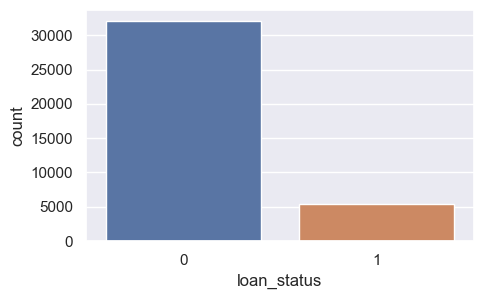

In [355]:
# check for amount of defaulters in the data using countplot
plt.figure(figsize=(5,3))
sns.countplot(x="loan_status", data=data)
plt.show()

- From above plot we can see that around 16% i.e. 5062 people are defaulters in total 35152 records

Categorical data

<Axes: xlabel='term', ylabel='count'>

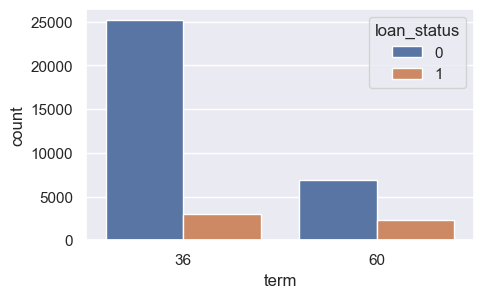

In [356]:
# check for defaulters wrt term in the data using countplot
plt.figure(figsize=(5,3))
sns.countplot(x= "term", hue='loan_status', data=data)

From above plot for 'term' we can infer that the defaulters rate is increasing wrt term, hence the chances of loan getting deaulted is less for 36m than 60m

<Axes: xlabel='grade', ylabel='count'>

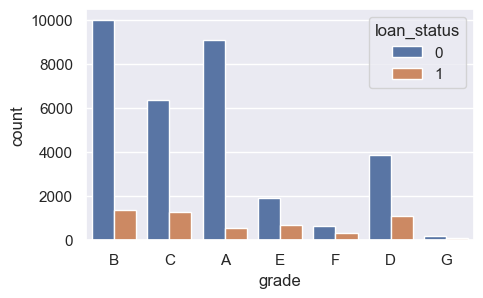

In [357]:
# check for defaulters wrt grade in the data using countplot
plt.figure(figsize=(5,3))
sns.countplot(x= "grade", hue='loan_status', data=data)

From above plot for 'grade' we can infer that the defaulters rate is increasing wrt grade, hence the chances of loan getting deaulted increases with the grade from A moving towards G

<Axes: xlabel='sub_grade', ylabel='count'>

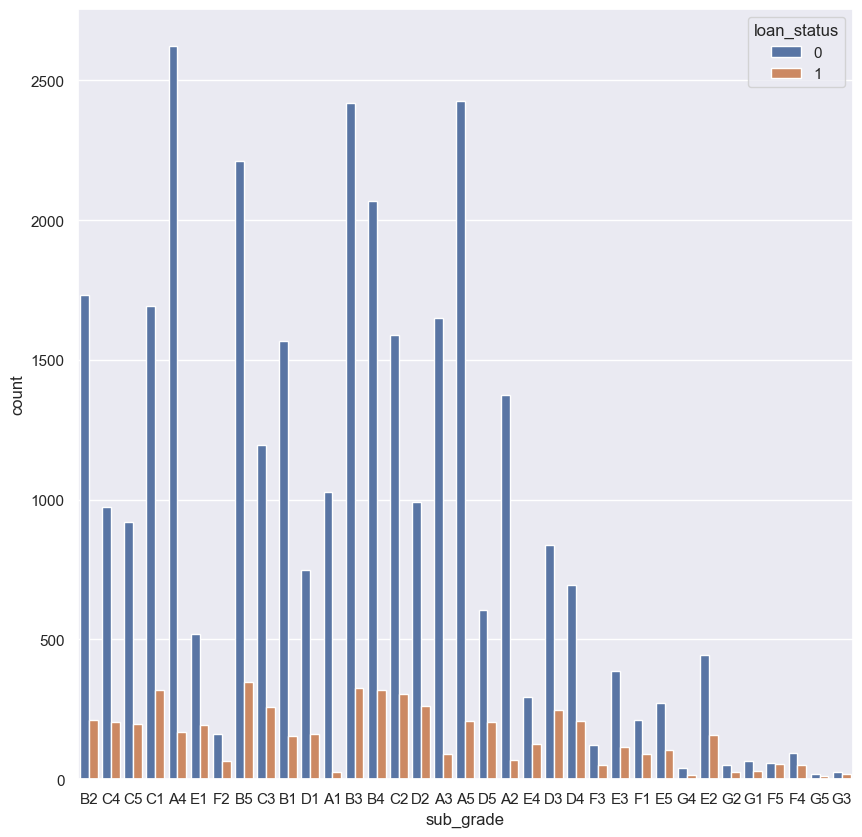

In [358]:
plt.figure(figsize=(10,10))
sns.countplot(x= "sub_grade", hue='loan_status', data=data)

From above plot for 'sub_grade' we can infer that the defaulters rate is increasing wrt sub_grade, hence the chances of loan getting deaulted increases with the sub_grade from A1 moving towards G5

<Axes: xlabel='home_ownership', ylabel='count'>

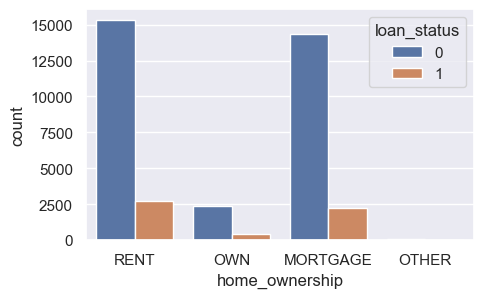

In [359]:
plt.figure(figsize=(5,3))
sns.countplot(x= "home_ownership", hue='loan_status', data=data)

From above plot for 'home_ownership' we can infer that the defaulters rate is constant here (it is quite more for OTHERS but we dont know what is in there, so we'll not consider it for analysis), hence defaulter does not depends on home_ownership

<Axes: xlabel='verification_status', ylabel='count'>

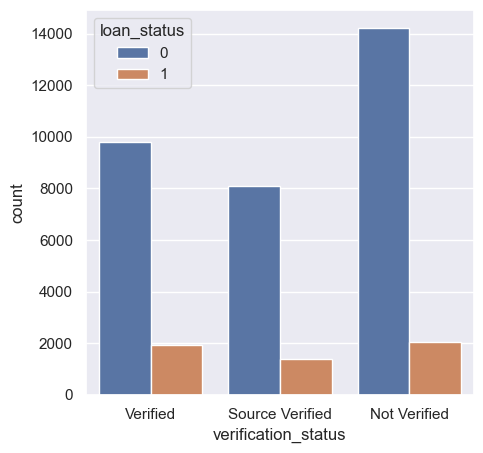

In [360]:
plt.figure(figsize=(5,5))
sns.countplot(x= "verification_status", hue='loan_status', data=data)

From above plot for 'verification_status' we can infer that the defaulters rate is increasing and is less for Not Verified users than Verified ones, but not useful for analysis.

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13]),
 [Text(0, 0, 'credit_card'),
  Text(1, 0, 'car'),
  Text(2, 0, 'small_business'),
  Text(3, 0, 'other'),
  Text(4, 0, 'wedding'),
  Text(5, 0, 'debt_consolidation'),
  Text(6, 0, 'home_improvement'),
  Text(7, 0, 'major_purchase'),
  Text(8, 0, 'medical'),
  Text(9, 0, 'moving'),
  Text(10, 0, 'vacation'),
  Text(11, 0, 'house'),
  Text(12, 0, 'renewable_energy'),
  Text(13, 0, 'educational')])

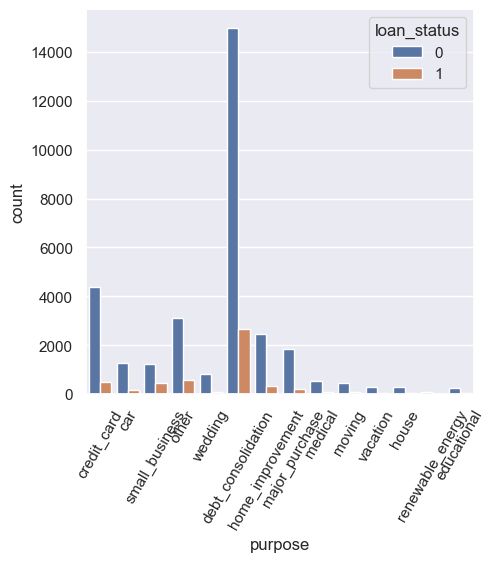

In [361]:
plt.figure(figsize=(5,5))
sns.countplot(x= "purpose", hue='loan_status', data=data)
plt.xticks(rotation =60)

From above plot for 'purpose' we can infer that the defaulters rate is nearly constant for all purpose type except 'small business', hence rate will depend on purpose of the loan

<Axes: xlabel='pub_rec', ylabel='count'>

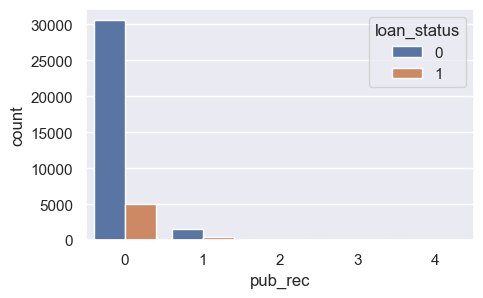

In [362]:
plt.figure(figsize=(5,3))
sns.countplot(x= "pub_rec", hue='loan_status', data=data)


From above plot for 'pub_rec' we can infer that the defaulters rate is nearly increasing as it is less for 0 and more for pub_rec with value 1, but as other values are very less as compared to 0 we'll not consider this

In [363]:
def plotUnivariateBar(x, figsize=(10,5)):
    plt.figure(figsize=figsize)
    palette = sns.color_palette("Set3")
    sns.barplot(x=x, y='loan_status', data=data,palette=palette)
    plt.xlabel(x, fontsize=10)
    plt.ylabel("defaulter ratio", fontsize=10)
    plt.show()

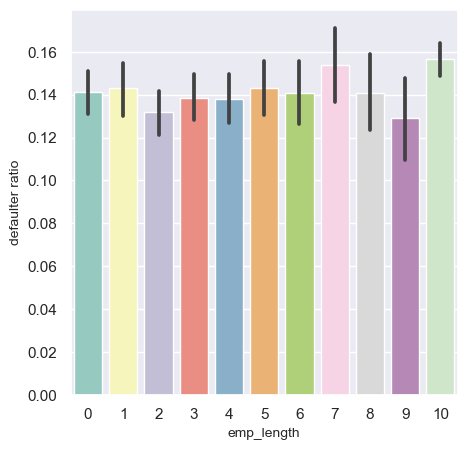

In [364]:
# check for defaulters wrt emp_length in the data using countplot
plotUnivariateBar("emp_length", figsize=(5,5))

From above plot for 'emp_length' we can infer that the defaulters rate is constant here, hence defaulter does not depends on emp_length

is emp_length benificial -> No

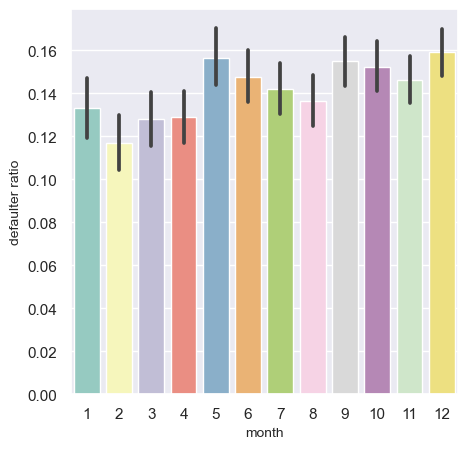

In [365]:
# check for defaulters wrt month in the data using countplot
plotUnivariateBar("month", figsize=(5,5))

From above plot for 'month' we can infer that the defaulters rate is nearly constant here, not useful

is month benificial -> No

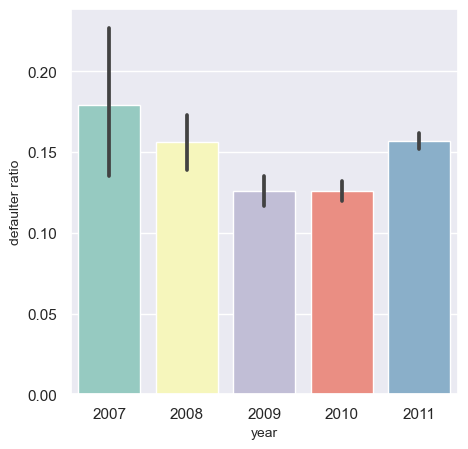

In [366]:
# check for defaulters wrt year in the data using countplot
plotUnivariateBar("year",figsize=(5,5))

From above plot for 'year' we can infer that the defaulters rate is nearly constant here, not useful

is year benificial -> No

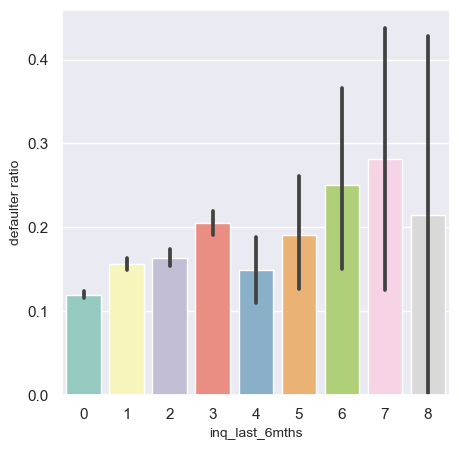

In [367]:
# check for defaulters wrt inq_last_6mths in the data using countplot
plotUnivariateBar("inq_last_6mths",figsize=(5,5))

From above plot for 'inq_last_6mths' we can infer that the defaulters rate is not consistently increasing with inq_last_6mths type, hence not useful

is inq_last_6mths benificial -> No

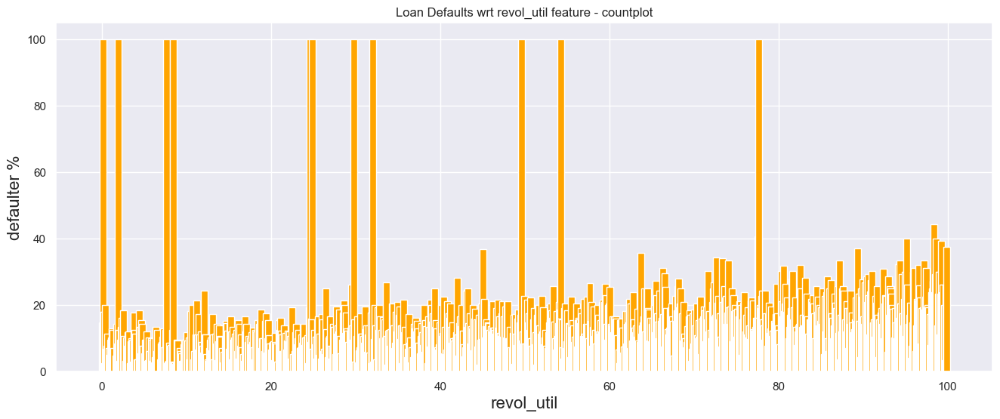

In [368]:
# check for defaulters wrt revol_util in the data using countplot
plotUnivariateRatioBar("revol_util", figsize=(16,6))

From above plot for 'revol_util' we can infer that the defaulters rate is fluctuating where some have complete 100% ratio for defaulter and is increasing as the magnitude increases, hence rate will depend on revol_util feature

is revol_util benificial -> Yes

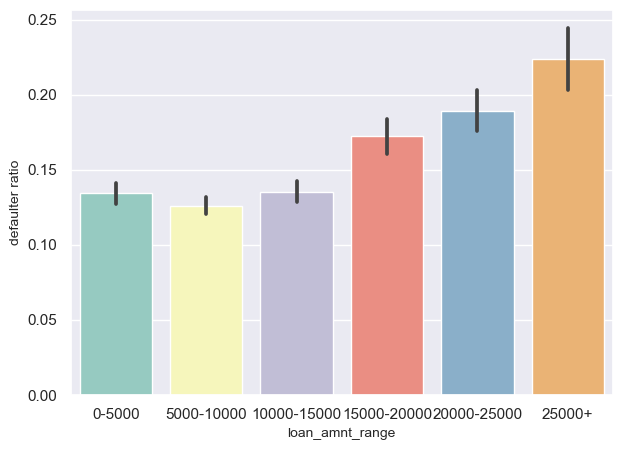

In [371]:
# check for defaulters wrt loan_amnt_range in the data using countplot
plotUnivariateBar("loan_amnt_range",figsize=(7,5))


From above plot for 'loan_amnt_range' we can infer that the defaulters rate is increasing loan_amnt_range values, hence rate will depend on loan_amnt_range feature

is loan_amnt_range benificial -> Yes

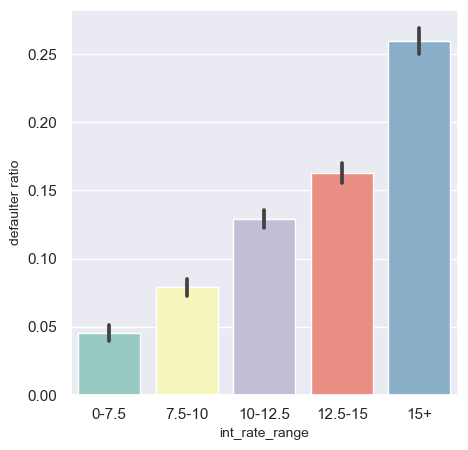

In [372]:
# check for defaulters wrt int_rate_range in the data using countplot
plotUnivariateBar("int_rate_range",figsize=(5,5))

From above plot for 'int_rate_range' we can infer that the defaulters rate is decreasing with int_rate_range values, hence rate will depend on int_rate_range feature

is int_rate_range benificial -> Yes

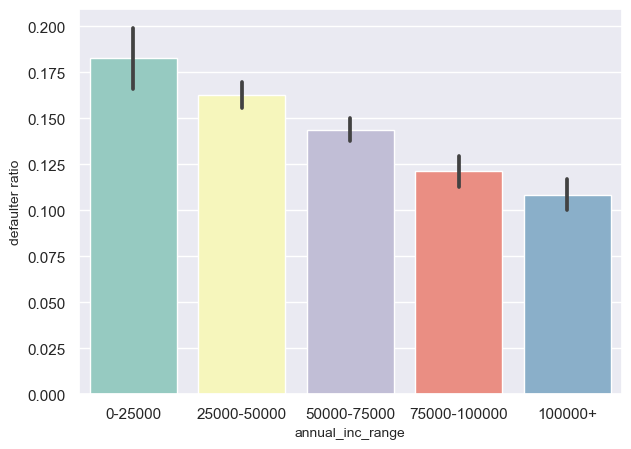

In [373]:
# check for defaulters wrt annual_inc_range in the data using countplot
plotUnivariateBar("annual_inc_range",figsize=(7,5))

From above plot for 'annual_inc_range' we can infer that the defaulters rate is decreasing as with annual_inc_range values, hence rate will depend on annual_inc_range feature

is annual_inc_range benificial -> Yes

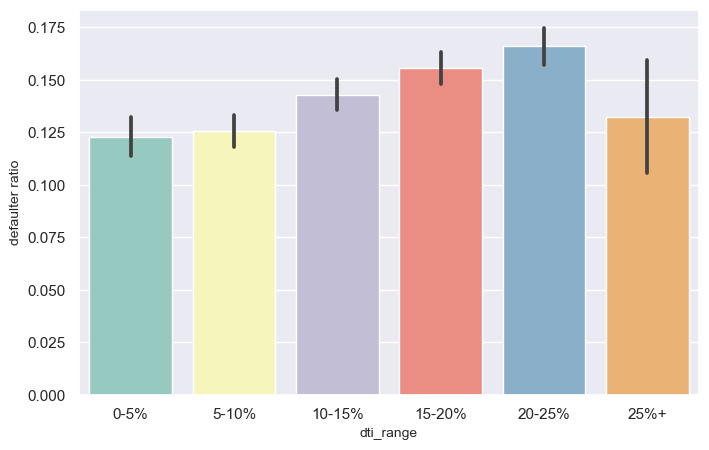

In [374]:
# check for defaulters wrt dti_range in the data using countplot
plotUnivariateBar("dti_range", figsize=(8,5))

From above plot for 'dti_range' we can infer that the defaulters rate is increasing as with dti_range values, hence rate will depend on dti_range feature

is dti_range benificial -> Yes

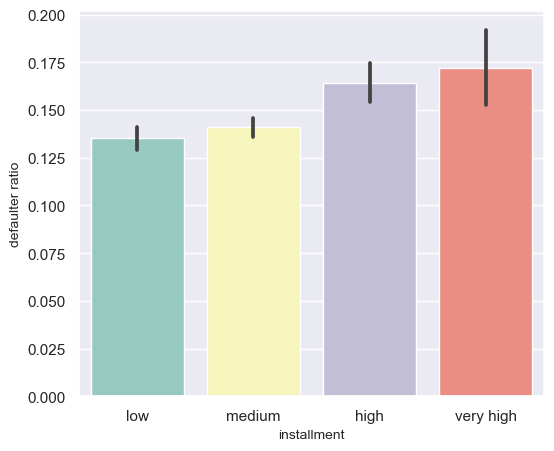

In [375]:
# check for defaulters wrt installment range in the data using countplot

plotUnivariateBar("installment", figsize=(6,5))



From above plot for 'installment' we can infer that the defaulters rate is increasing as with installment values, hence rate will depend on dti_range feature

is installment benificial -> Yes

##### Hence, important feature from above Univariate analysis are:

##### term, grade, purpose, pub_rec, revol_util, funded_amnt_inv, int_rate, annual_inc, dti, installment

### Bivaraite analysis

- Analysing two attributes togther

In [376]:
# function to plot scatter plot for two features
def plotScatter(x, y):
    plt.figure(figsize=(16,6))
    sns.scatterplot(x=x, y=y, hue="loan_status", data=data)
    plt.title("Scatter plot between "+x+" and "+y,fontsize=10)
    plt.xlabel(x, fontsize=10)
    plt.ylabel(y, fontsize=10)
    plt.show()
    
def plotBivariateBar(x, hue, figsize=(16,6)):
    plt.figure(figsize=figsize)
    sns.barplot(x=x, y='loan_status', hue=hue, data=data)
    plt.title("Loan Default ratio wrt "+x+" feature for hue "+hue+" in the data using countplot")
    plt.xlabel(x, fontsize=10)
    plt.ylabel("defaulter ratio", fontsize=10)
    plt.show()

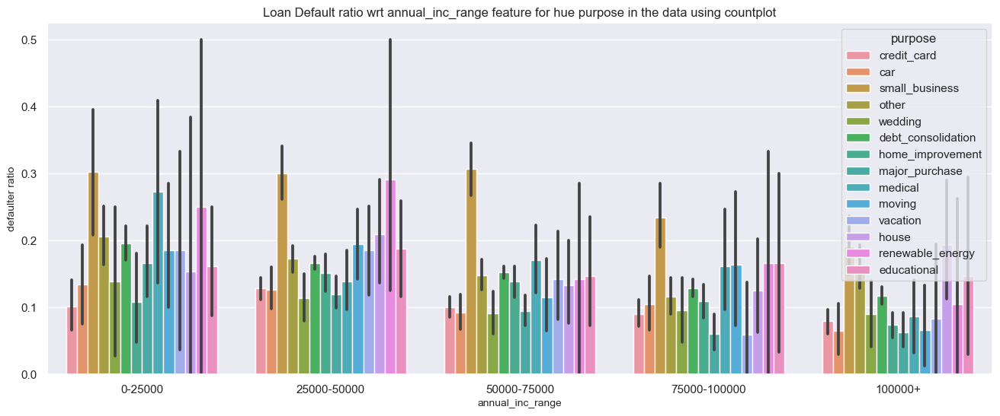

In [377]:
# check for defaulters wrt annual_inc and purpose in the data using countplot
plotBivariateBar("annual_inc_range", "purpose")

From above plot, we can infer it doesn't shows any correlation

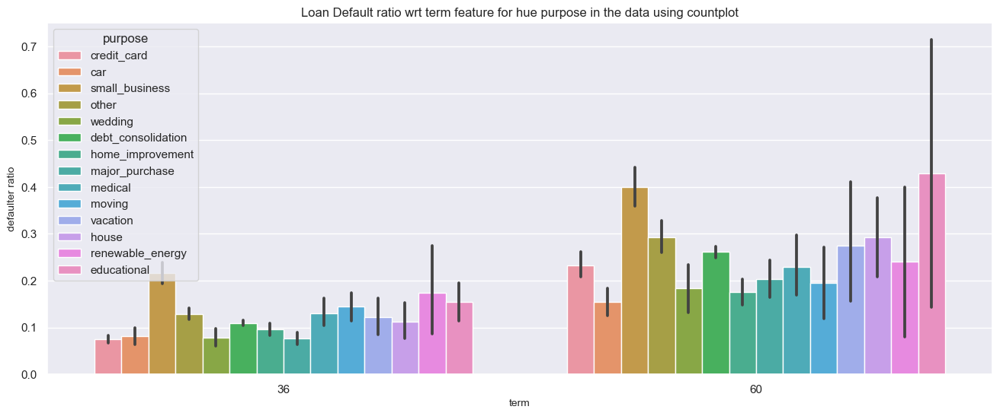

In [378]:
# check for defaulters wrt term and purpose in the data using countplot
plotBivariateBar("term", "purpose")


As we can see straight lines on the plot, default ratio increases for every purpose wrt term

related - Y

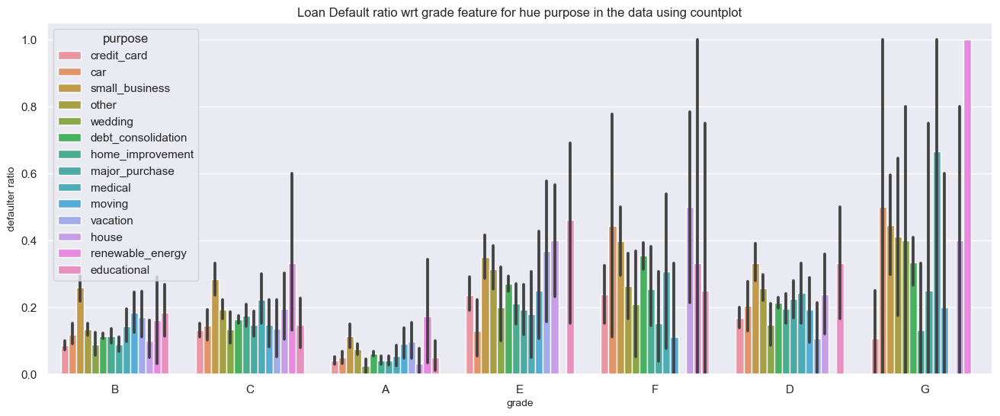

In [379]:
# check for defaulters wrt grade and purpose in the data using countplot
plotBivariateBar("grade", "purpose")

As we can see straight lines on the plot, default ratio increases for every purpose wrt grade

related - Y

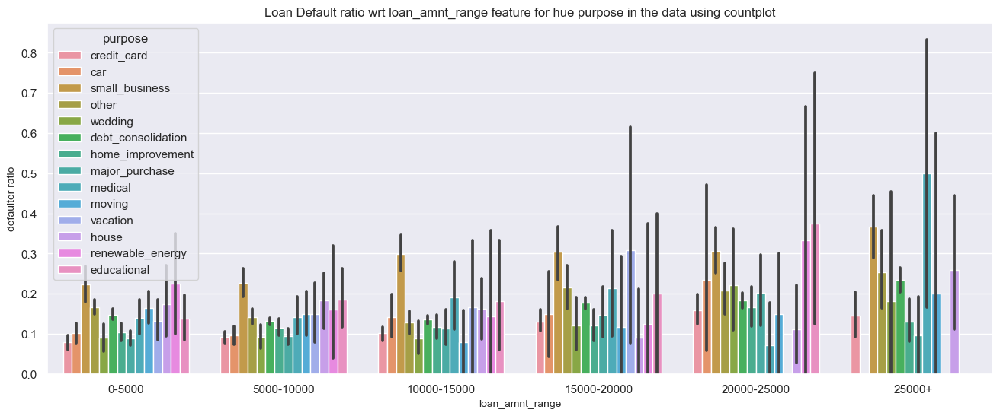

In [380]:
# check for defaulters wrt loan_amnt_range and purpose in the data using countplot
plotBivariateBar("loan_amnt_range", "purpose")

As we can see straight lines on the plot, default ratio increases for every purpose wrt loan_amnt_range

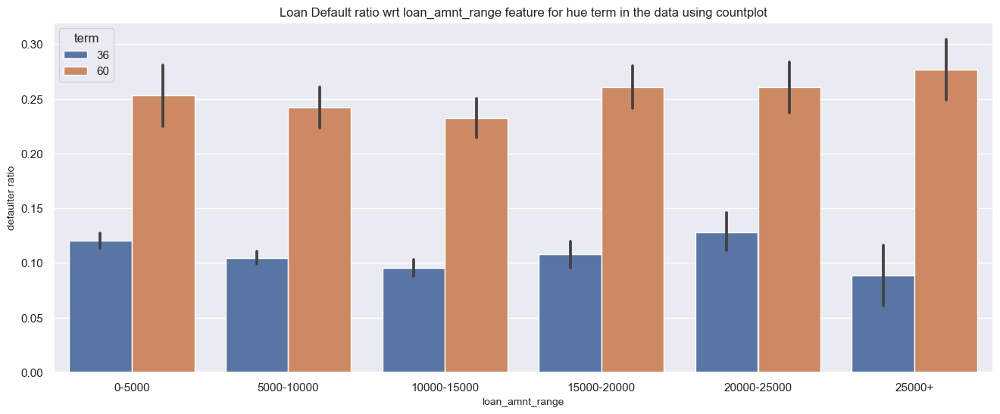

In [381]:
# check for defaulters wrt loan_amnt_range and term in the data using countplot
plotBivariateBar("loan_amnt_range", "term")

As we can see straight lines on the plot, default ratio increases for every term wrt loan_amnt_range

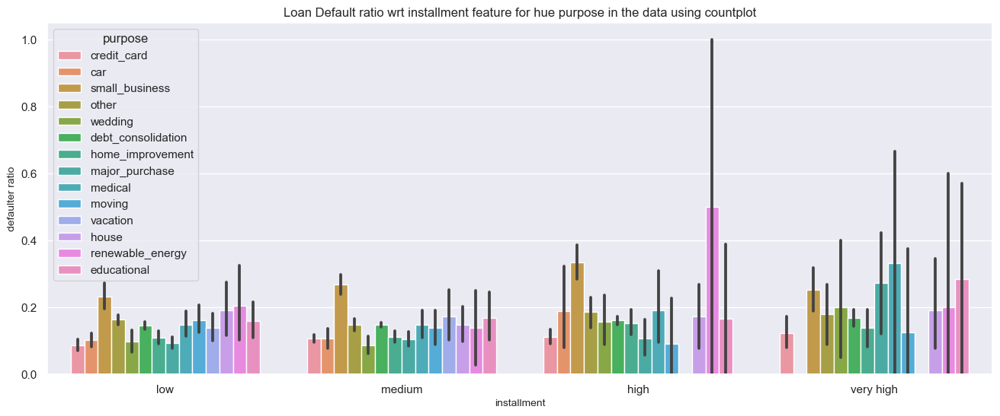

In [382]:
# check for defaulters wrt annual_inc_range and purpose in the data using countplot
plotBivariateBar("installment", "purpose")

As we can see straight lines on the plot, default ratio increases for every purpose wrt installment except for small_business

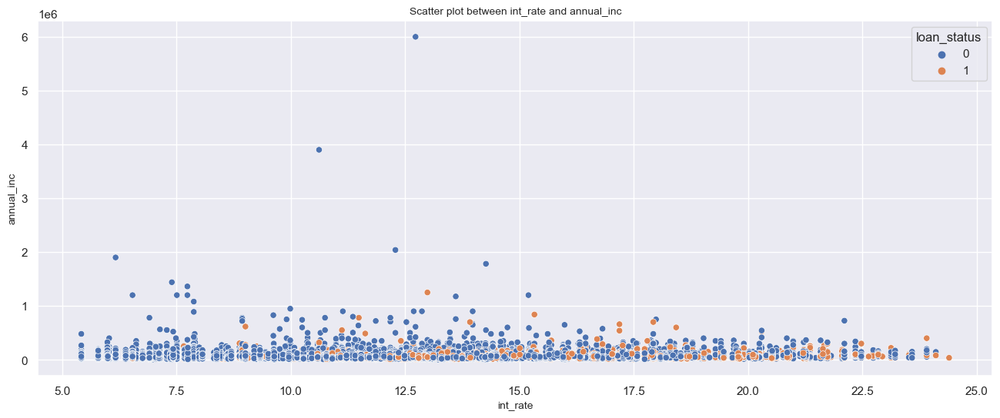

In [383]:
# check for defaulters wrt loan_amnt_range in the data using countplot
plotScatter("int_rate", "annual_inc")

There is no relation between above mentioned features

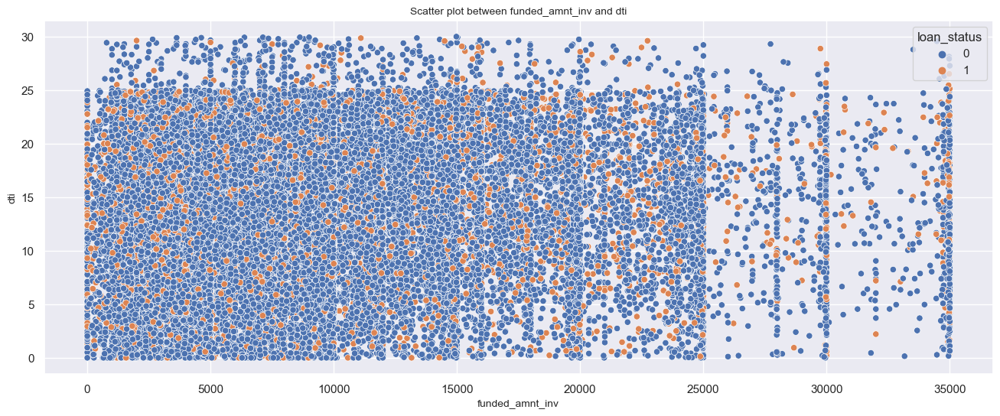

In [384]:
# plot scatter for funded_amnt_inv with dti
plotScatter("funded_amnt_inv", "dti")

As we can see straight lines on the plot, there is no relation between above mentioned features

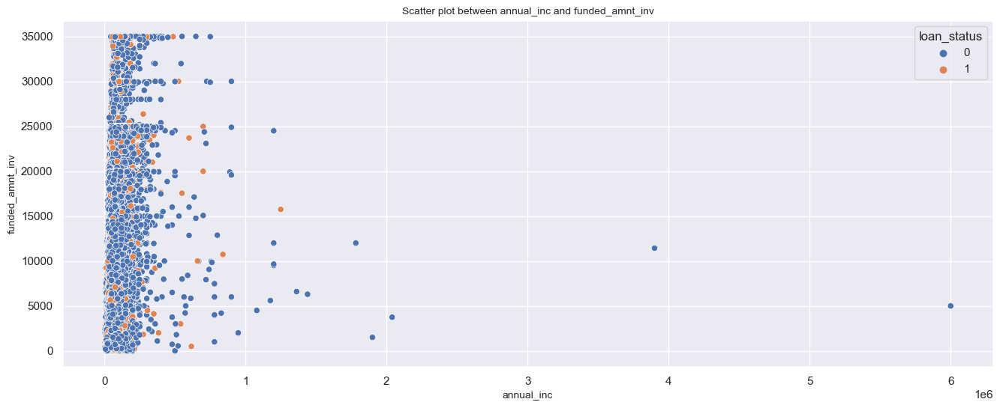

In [385]:
# plot scatter for funded_amnt_inv with annual_inc
plotScatter("annual_inc", "funded_amnt_inv")

As we can see increasing pattern on the plot, there is positive relation between above mentioned features

<Axes: xlabel='loan_amnt', ylabel='int_rate'>

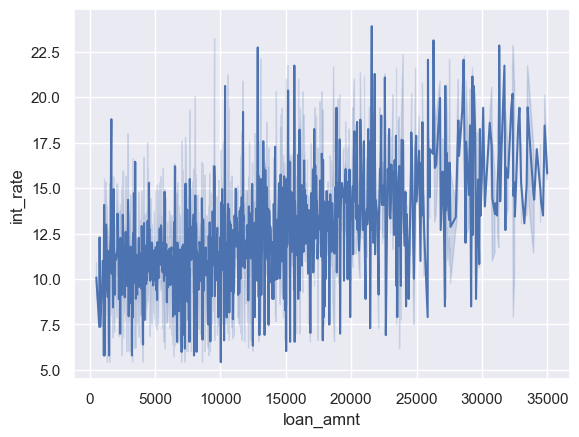

In [386]:
# plot scatter for loan_amnt with int_rate
sns.lineplot(x= data["loan_amnt"], y= data["int_rate"])

As we can see straight line patterns on the plot, there is no relation between above mentioned features

<Axes: xlabel='int_rate', ylabel='annual_inc'>

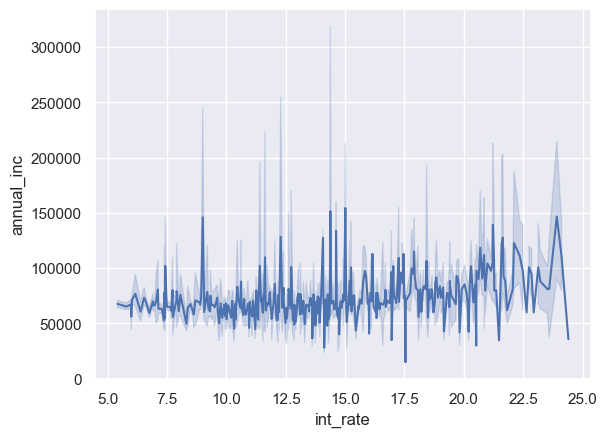

In [387]:

# plot scatter for loan_amnt with int_rate
sns.lineplot(x= data["int_rate"], y= data["annual_inc"])

As we can see negative correlation pattern with reduced density on the plot, there is some relation between above mentioned features

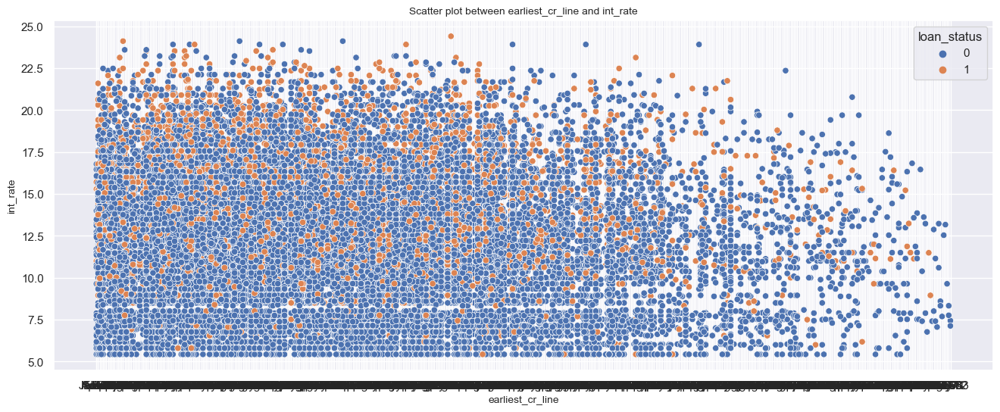

In [388]:
# plot scatter for earliest_cr_line with int_rate
plotScatter("earliest_cr_line", "int_rate")

As we can see positive correlation pattern with increasing density on the plot, there is co-relation between above mentioned features

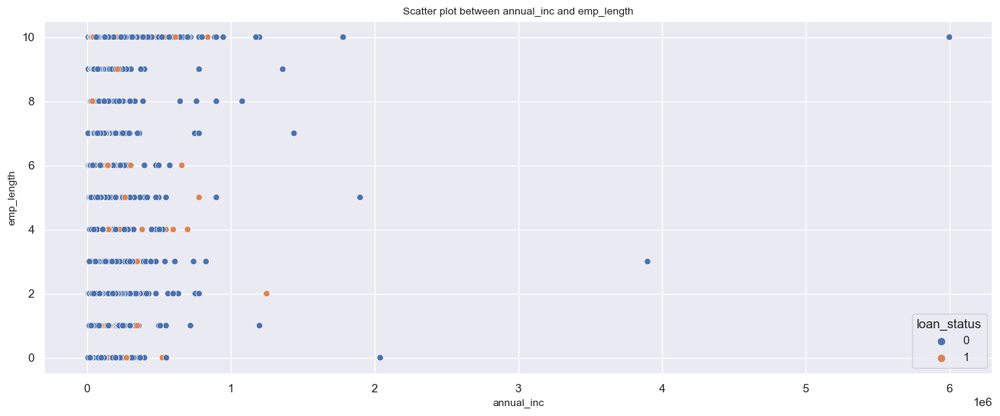

In [389]:
# plot scatter for annual_inc with emp_length
plotScatter("annual_inc", "emp_length")

As we can see straight line patterns on the plot, there is no relation between above mentioned features

In [390]:
# function to plot boxplot for comparing two features
def plotBox(x, y, hue="loan_status"):
    plt.figure(figsize=(16,6))
    sns.boxplot(x=x, y=y, data=data, hue=hue, order=sorted(data[x].unique()))
    plt.title("Box plot between "+x+" and "+y+" for each "+hue)
    plt.xlabel(x, fontsize=16)
    plt.ylabel(y, fontsize=16)
    plt.show()
    plt.figure(figsize=(16,8))
    sns.violinplot(x=x, y=y, data=data, hue=hue, order=sorted(data[x].unique()))
    plt.title("Violin plot between "+x+" and "+y+" for each "+hue)
    plt.xlabel(x, fontsize=16)
    plt.ylabel(y, fontsize=16)
    plt.show()

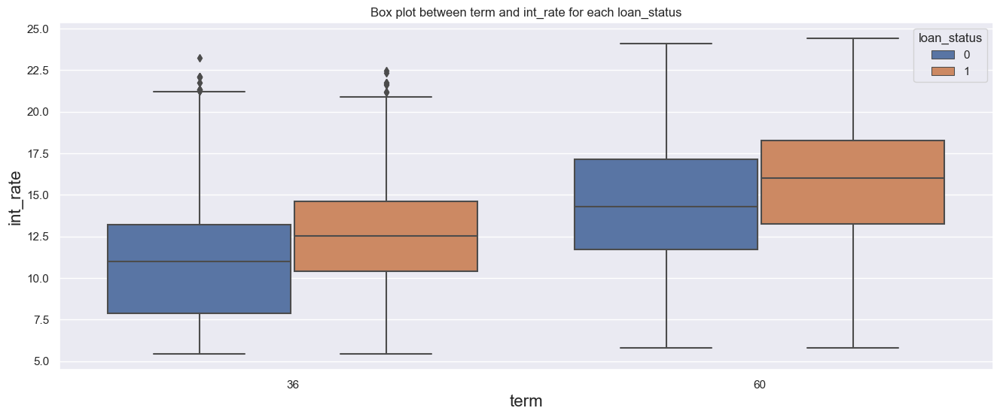

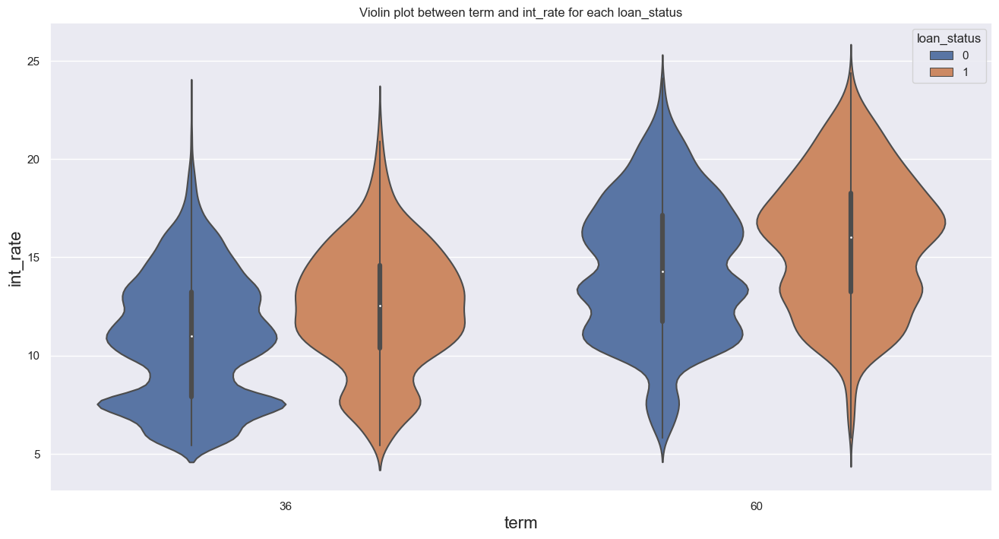

In [391]:
# plot box for term vs int_rate for each loan_status
plotBox("term", "int_rate")

int_rate increases with term on loan and the chances of default also increases

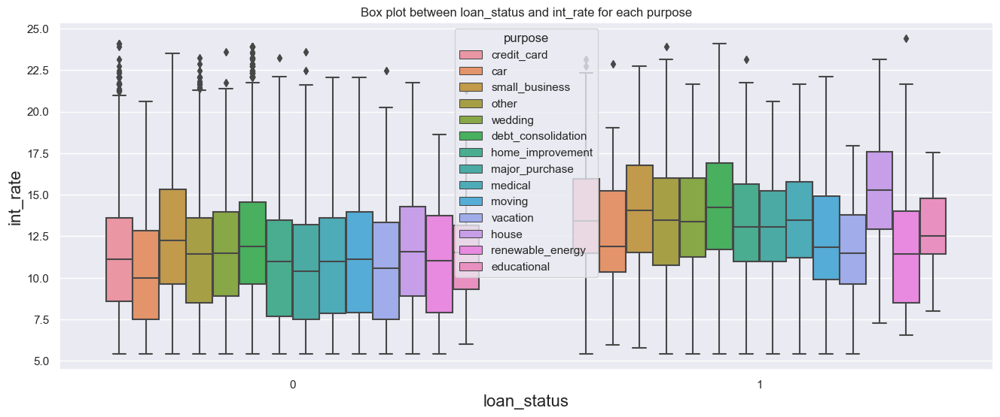

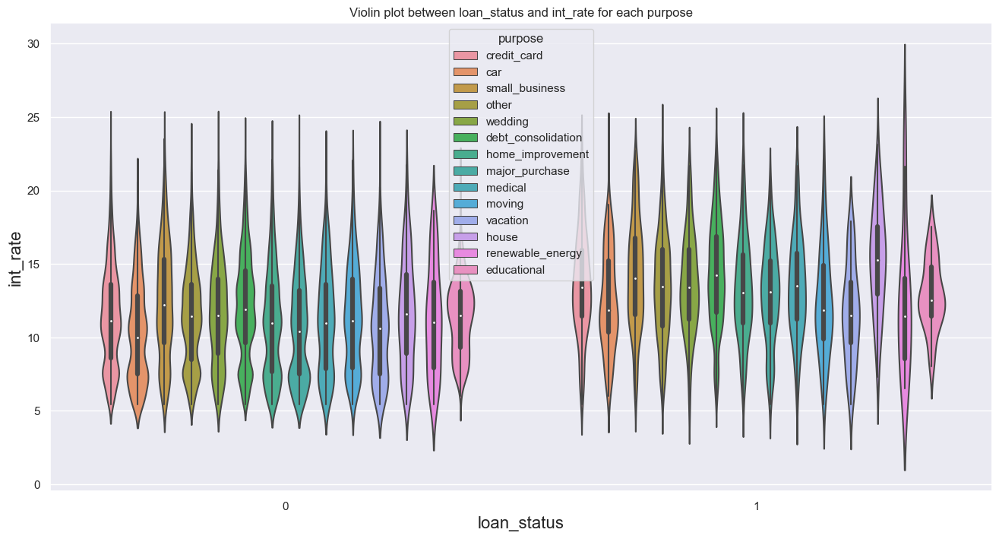

In [392]:
# plot box for loan_status vs int_rate for each purpose
plotBox("loan_status", "int_rate", hue="purpose")

int_rate is quite high where the loan is defaulted for every purpose value

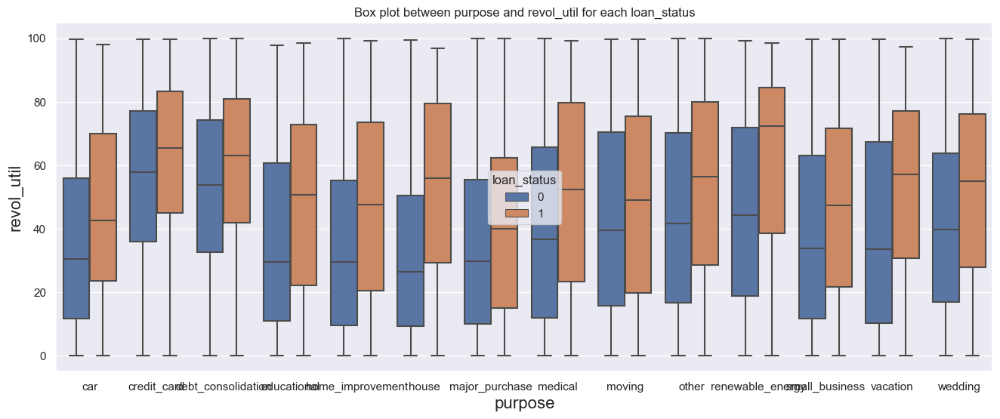

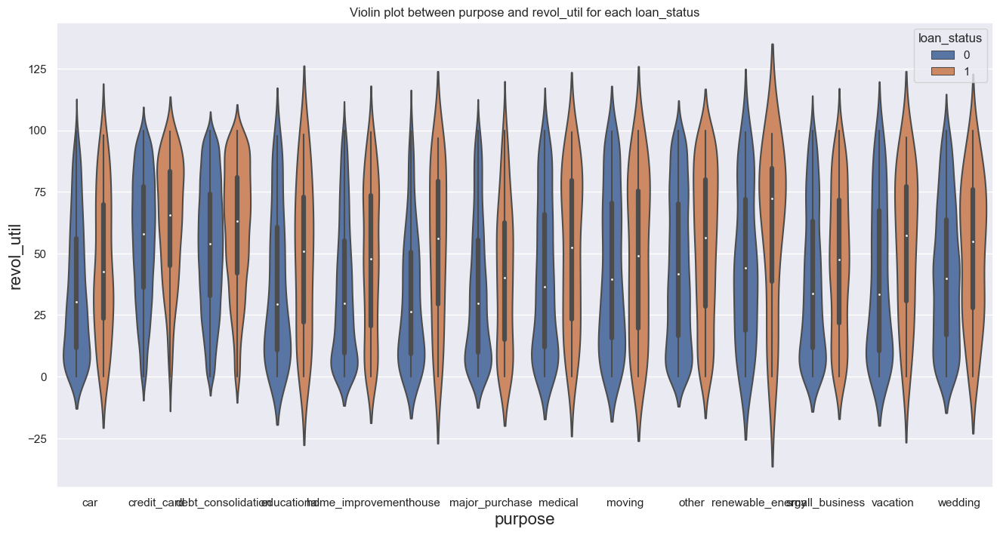

In [393]:
# plot box for purpose vs revo_util for each status
plotBox("purpose", "revol_util")


revol_util is more for every purpose value where the loan is defaulted and quite high for credit_card

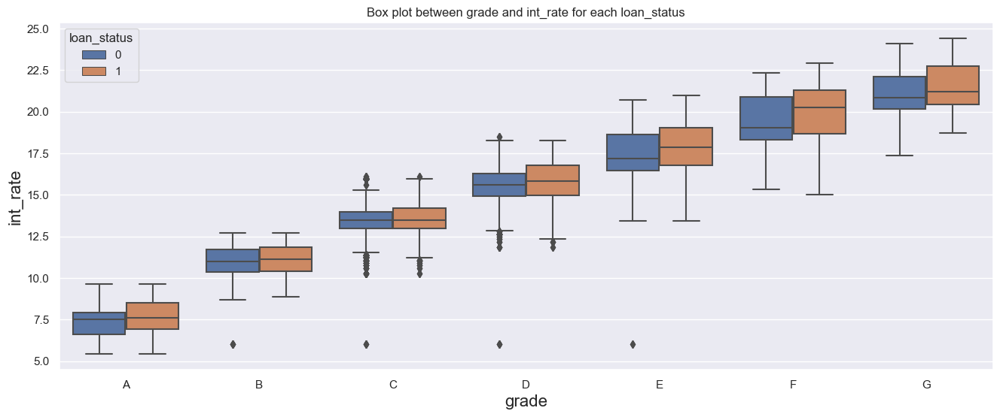

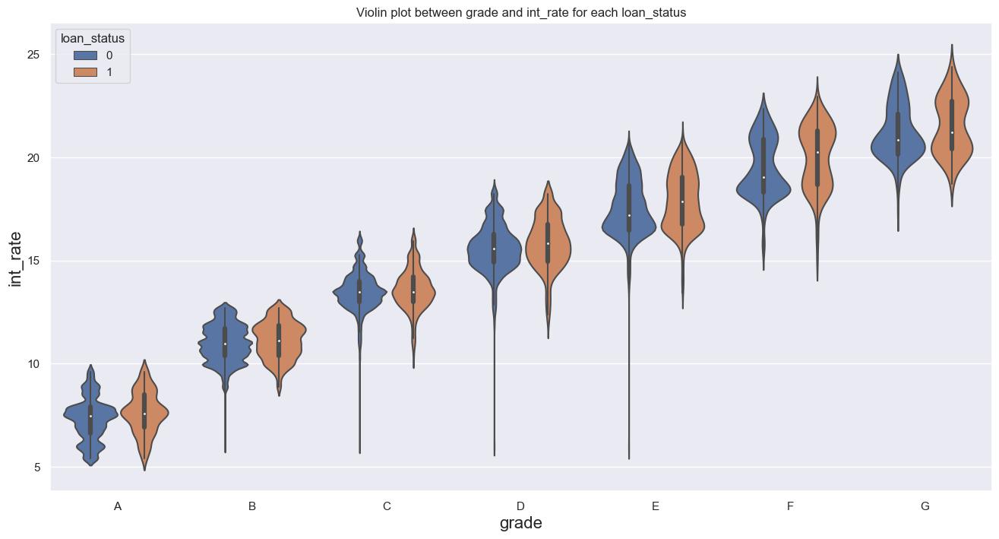

In [394]:
# plot box for grade vs int_rate for each loan_status
plotBox("grade", "int_rate", "loan_status")

int_rate is increasing with every grade and also the defaulters for every grade are having their median near the non-defaulter 75% quantile of int_rate

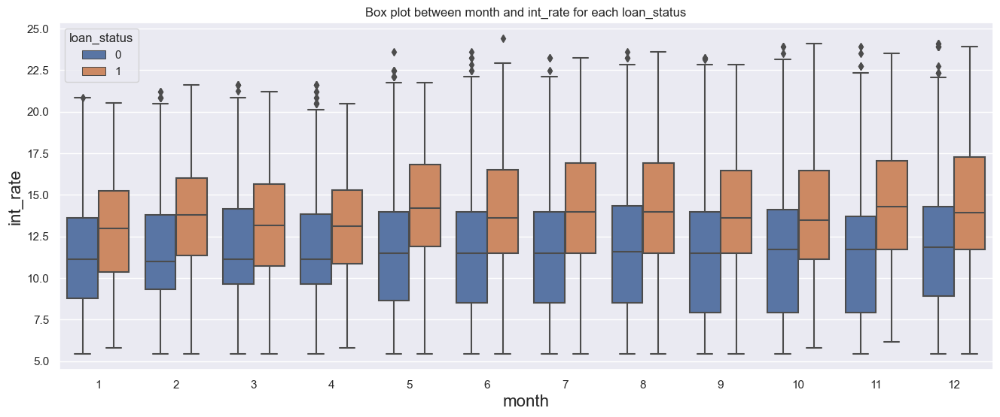

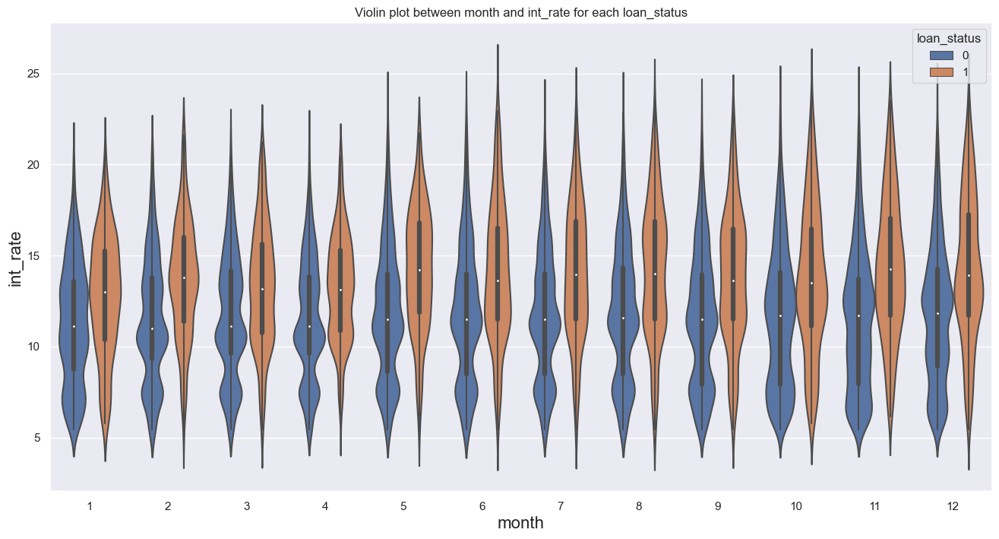

In [395]:
# plot box for issue_d vs int_rate for each loan_status
plotBox("month", "int_rate", "loan_status")

int_rate for defaulter is increasing with every month where the defaulters for every month are having their median near the non-defaulter's 75% quantile of int_rate, but is almost constant for each month, not useful

##### Hence, important feature from above Bivariate analysis are:

##### term, grade, purpose, pub_rec, revol_util, funded_amnt_inv, int_rate, annual_inc, installment

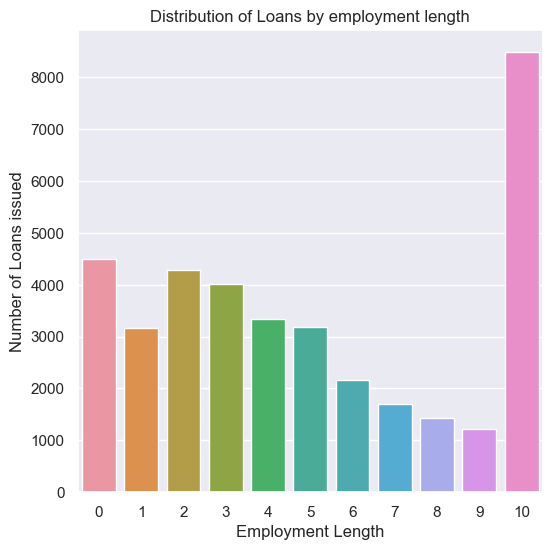

In [396]:
# Distribution of Loans by employment length
plt.figure(figsize=(6,6))
sns.countplot(x='emp_length', data=data)
plt.title('Distribution of Loans by employment length')
plt.xlabel("Employment Length")
plt.ylabel("Number of Loans issued")
plt.show()

The majority of borrowers have been employed for at least 10 years

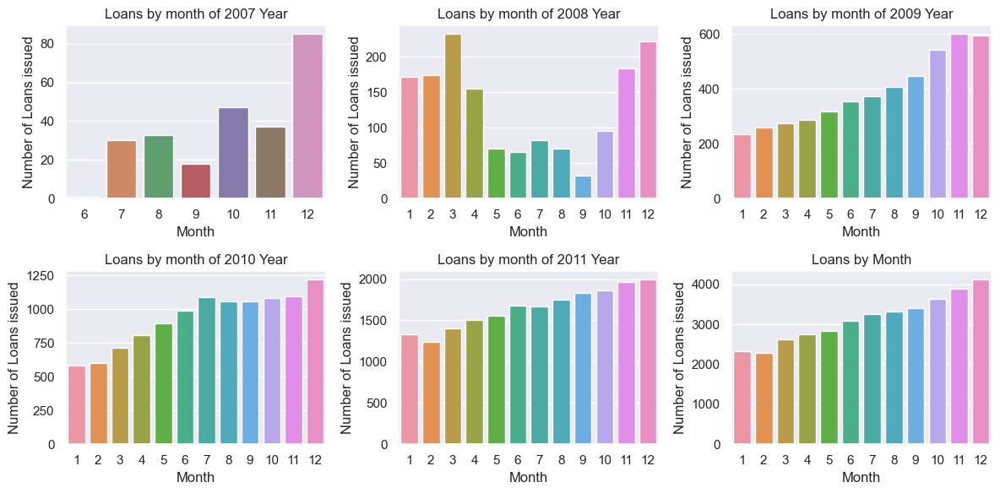

In [397]:
# Number of loans issued (by year/month)
plt.figure(figsize=(12,6))

plt.figure(1)

plt.subplot(2,3,1)
sns.countplot(x="month", data=data[data['year']==2007])
plt.title("Loans by month of 2007 Year")
plt.xlabel("Month")
plt.ylabel("Number of Loans issued")

plt.subplot(2,3,2)
sns.countplot( x="month", data=data[data['year']==2008])
plt.title("Loans by month of 2008 Year")
plt.xlabel("Month")
plt.ylabel("Number of Loans issued")

plt.subplot(2,3,3)
sns.countplot( x="month", data=data[data['year']==2009])
plt.title("Loans by month of 2009 Year")
plt.xlabel("Month")
plt.ylabel("Number of Loans issued")

plt.subplot(2,3,4)
sns.countplot( x="month", data=data[data['year']==2010])
plt.title("Loans by month of 2010 Year")
plt.xlabel("Month")
plt.ylabel("Number of Loans issued")

plt.subplot(2,3,5)
sns.countplot( x="month", data=data[data['year']==2011])
plt.title("Loans by month of 2011 Year")
plt.xlabel("Month")
plt.ylabel("Number of Loans issued")

plt.subplot(2,3,6)
sns.countplot( x="month", data=data)
plt.title("Loans by Month")
plt.xlabel("Month")
plt.ylabel("Number of Loans issued")

# To adjust spacing between subplots
plt.tight_layout()
plt.show()

Observations:

From above plots, it shows that more number of loans were issued in 11,12(November, December) months, the reasons could be Festivals(Thanks giving Day, Christmas and New Year).

In 2008 Year, there was huge spike in 3rd Month.

Number of loans issued increased steadily with slight descrease in 2008 year.

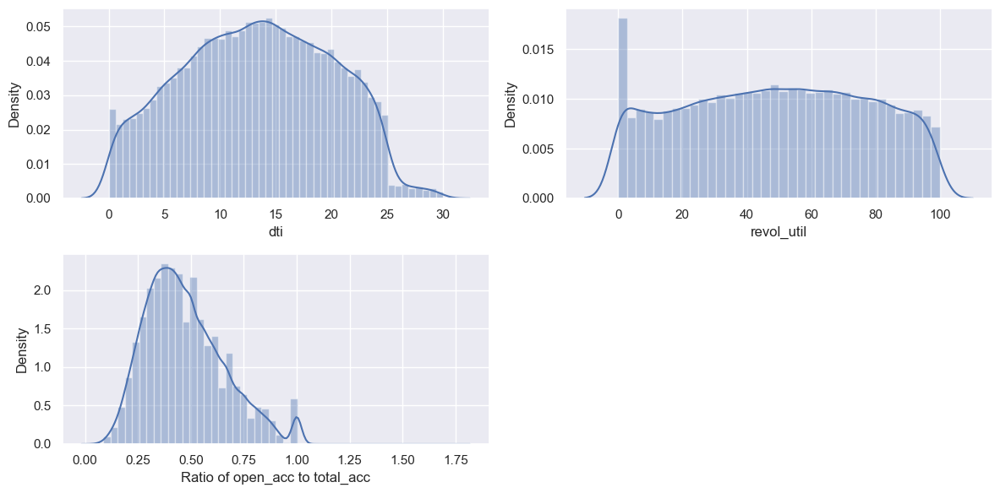

In [398]:
# Frequency distributions
plt.figure(figsize=(12,6))

plt.figure(1)

# Frequency distribution of DTI
plt.subplot(2,2,1)
sns.distplot(data["dti"])

# Frequency distribution of revolving credit uilization
plt.subplot(2,2,2)
sns.distplot(data["revol_util"])

# Frequency distribution of ration of open_acc to total_acc
plt.subplot(2,2,3)
sns.distplot(data["open_acc"]/data["total_acc"])
plt.xlabel("Ratio of open_acc to total_acc")

# To adjust spacing between subplots
plt.tight_layout()
plt.show()




The average debt-to-income ratio is 13%. There doesn’t seem to be much skew, considering the median is so close to the mean.

The mean of revolving credit utilization is 49%, which means the average borrower is using most of their revolving credit at a time when they are seeking the loan. Also, there is large spread of data but not much skewed.

The percentage of open accounts to total accounts seems left skewed.

#### Multivariate analysis

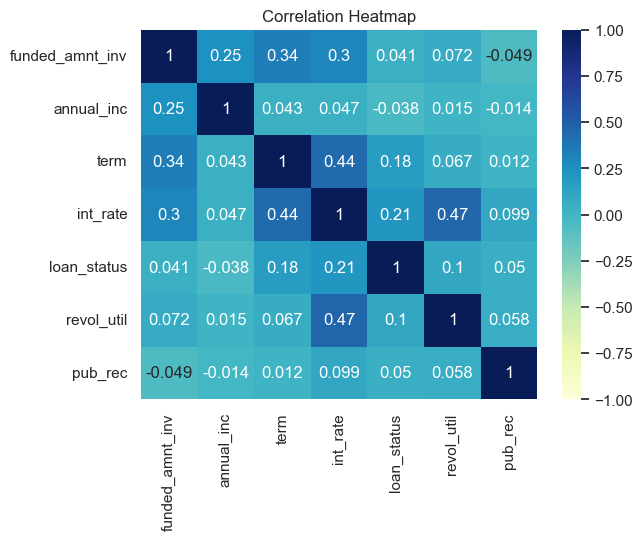

In [399]:
# plot heat map to see correlation between features
continuous_f = ["funded_amnt_inv", "annual_inc", "term", "int_rate", "loan_status", "revol_util", "pub_rec"]
loan_corr = data[continuous_f].corr()
sns.heatmap(loan_corr,vmin=-1.0,vmax=1.0,annot=True, cmap="YlGnBu")
plt.title("Correlation Heatmap")
plt.show()

Hence, important related feature from above  analysis are:

term, grade, purpose, revol_util, int_rate, installment, annual_inc, funded_amnt_inv

<Figure size 2000x1500 with 0 Axes>

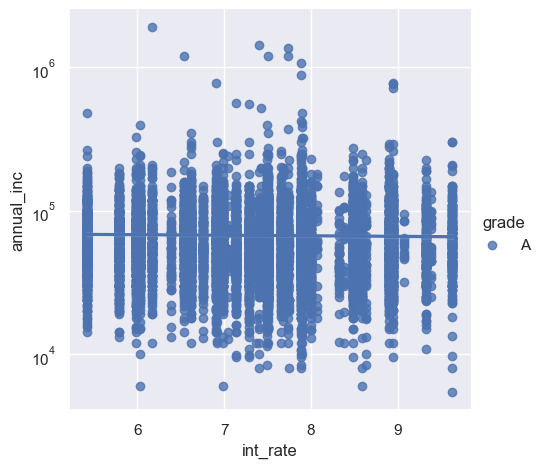

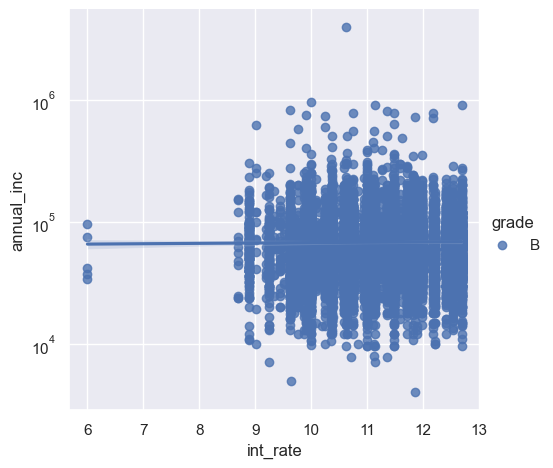

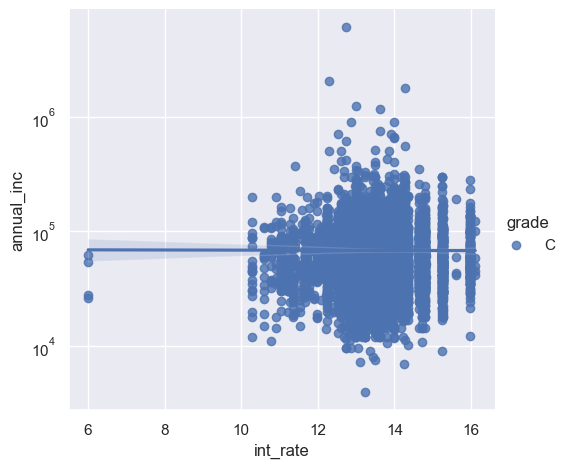

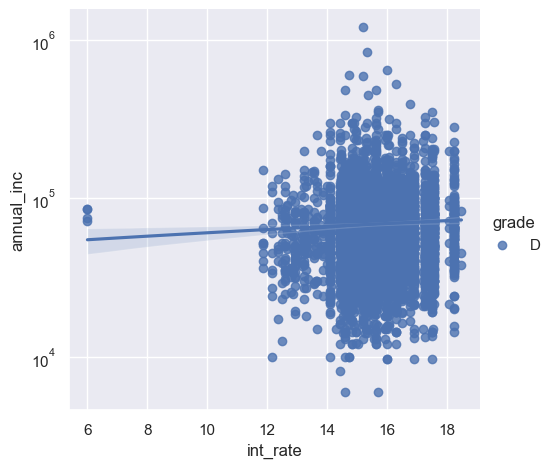

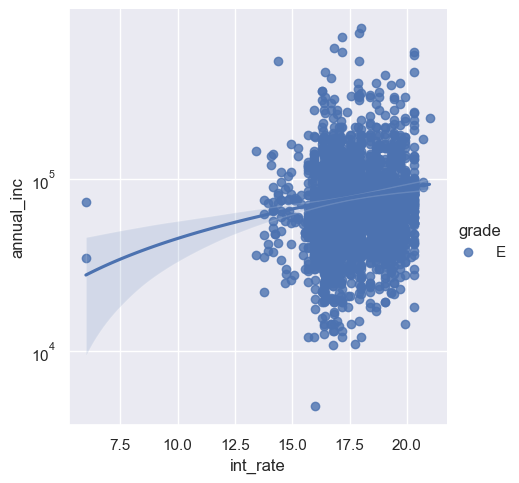

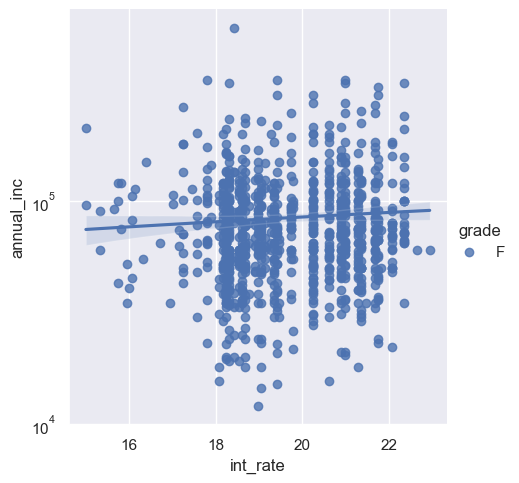

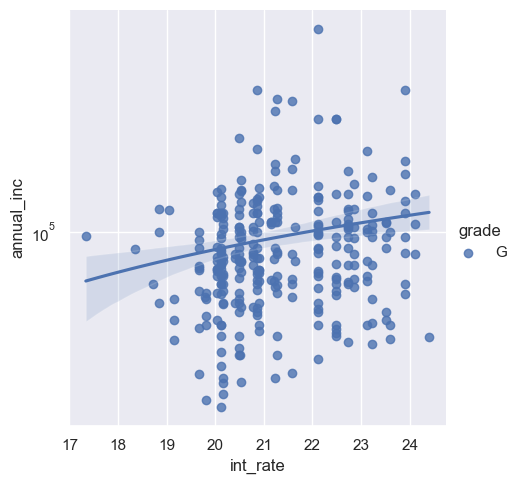

In [400]:
# Annual Income Vs Interest Rate distribution by each grade
plt.figure(figsize=(20,15))

sns.lmplot( x="int_rate", y="annual_inc", data=data[data['grade']=='A'], hue='grade')
plt.yscale('log')


sns.lmplot( x="int_rate", y="annual_inc", data=data[data['grade']=='B'], hue='grade')
plt.yscale('log')


sns.lmplot( x="int_rate", y="annual_inc", data=data[data['grade']=='C'], hue='grade')
plt.yscale('log')


sns.lmplot( x="int_rate", y="annual_inc", data=data[data['grade']=='D'], hue='grade')
plt.yscale('log')

sns.lmplot( x="int_rate", y="annual_inc", data=data[data['grade']=='E'], hue='grade')
plt.yscale('log')

sns.lmplot( x="int_rate", y="annual_inc", data=data[data['grade']=='F'], hue='grade')
plt.yscale('log')

sns.lmplot( x="int_rate", y="annual_inc", data=data[data['grade']=='G'], hue='grade')
plt.yscale('log')

plt.show()

Grade A has borrowers with interest rate between 5-10%.

Grade B has borrowers with interest rate between 8-13%, but few are there with near 6%.

Grade C has borrowers with interest rate between 10-16%, but few are there with near 6%.

Grade D has borrowers with interest rate between 12-18%, but few are there with near 6%.

Grade E has borrowers with interest rate between 14-20%, but few are there with near 6%.

Grade F has borrowers with interest rate between 15-23%.

Grade G has borrowers with interest rate between 17-24%.

It is evident that the interest rate range changes from one grade to other, and also there are few borrowers with near 6% falling in B,C,D and E grade's.

#### Loan Defaulters Analysis:
- Distribution of Loan Defaulters by Loan Purpose: a) There are more defaulters from 'debt_consolidation','other', 'credit_card' and 'small_business'. Let's check this at granular level by combining with Home Ownership and by each Grade.

- Distribution of Loan Defaulters by Home Ownerships: a) By charts, it shows there are more defaulters in RENT and MORTGAGE.

- Distribution of Loan Defaulters by Home Ownerships & Loan Purpose: a) There are more defaulters with 'debt_consolidation', 'credit_card' and 'small_business' purpose from Rent, Mortgage category and hence, should be carefull when borrowers don't have own house.

- Distribution of Loan Defaulters by Grade: a) By charts, it shows there are more defaulters in B,C and D grades. b) Grades F,G(more intereste rate grades) are having less defaulters which is a good indicator.

- Distribution of Loan Defaulters by Grade & Loan Purpose: By charts, from all grades, there are more defaulters from 'debt_consolidation', 'others', 'credit_card' and 'small_business' purpose loans.

#### Conclusion:
- Number of loans issued increased steadily by every year with a slight decrease in 2008.

- Of settled loans, 83% were Fully Paid and 14% were Charged Off.

- Borrowers with own house and the purpose of loan with consolidate debt, 'credit_card' and 'small_business' are not at much risk, but borrower with rent,mortgage are high risk applicants.

- Majority of loans were from A, B, and C grade.

- There is an inverse relationship between interest rate and loan grade - lower grades(E,F,G) have higher interest rate.

- From ROI analysis, it shows that borrowers with the best credit profiles or the lowest loan amounts will not end up being the most profitable and the borrowers who seemed to have worst credit indicators ended up being more profitable from E,F,G grades.

- Overall, there are more defaulters from 'debt_consolidation', 'others', 'credit_card' and 'small_business' purpose loans from all grades.


#### Final Findings
- The best driving features for the Loan default are: term, grade, purpose, revol_util, int_rate, installment, annual_inc, funded_amnt_inv

### Profiling auto EDA

In [401]:
from pandas_profiling import ProfileReport
profile = ProfileReport(data,title='Report')
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]